In [42]:
import autosklearn.regression
import sklearn.metrics
import pandas as pd
import numpy as np
import plotly.graph_objs as go
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
%matplotlib inline
init_notebook_mode(connected=True)

In [9]:
config = {
    "gap_scenario": '15min', # '1h', '1min', '15min',
    "random_seed": 21321,
    "train_set_ratio": 0.8,
    "window_size": 10 # number of previosu values chosen for prediction
}

# Import Energy dataset

In [3]:
energy_path = "res/energy/iiitd/Academic Block/Building Total Mains/0/Power.csv"
df_energy = pd.read_csv(energy_path, header=None, names=['timestamp', 'consumption'])
df_energy['date'] = pd.to_datetime(df_energy['timestamp'], unit='ms')
df_energy.head(2)

,timestamp,consumption,date
0,1.401696e+12,40767.359375,2014-06-02 07:56:23
1,1.401696e+12,41936.476562,2014-06-02 07:56:53


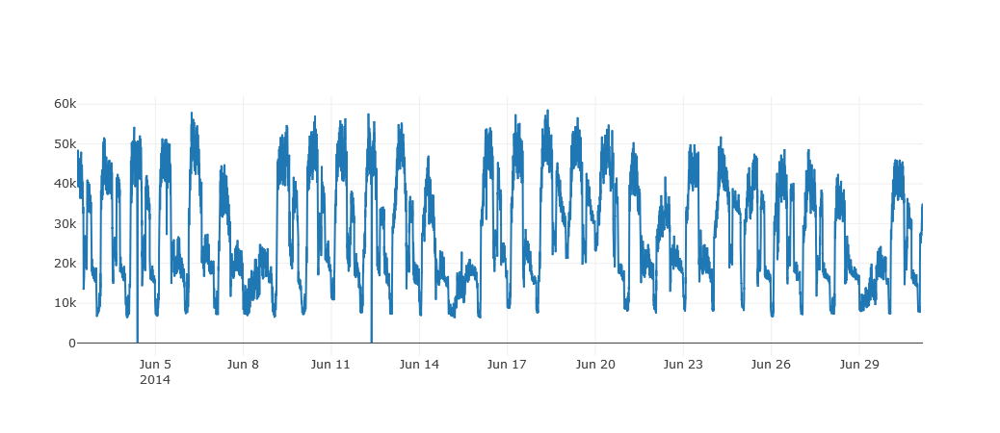

In [4]:
iplot([go.Scatter(x=df_energy['date'], y=df_energy['consumption'])])

In [5]:
# calculate median amount of values per interval
df_energy.set_index('date').resample('15min').count().median()

timestamp      30.0
consumption    30.0
dtype: float64

In [6]:
gap_length = 1
# assign mean gap length per time unit
if config["gap_scenario"] == '1d':
    gap_length = 2874
elif config["gap_scenario"] == '1h':
    gap_length = 120
elif config["gap_scenario"] == '15min':
    gap_length = 30
elif config["gap_scenario"] == '1min':
    gap_length = 2
    
print(f"Scenario {config['gap_scenario']}: using gap length of {gap_length}")

Scenario 15min: using gap length of 30


### Train/Test Splits
define random cut points within interval [gap_length, value_count]

In [88]:
# fix seed
np.random.seed(config["random_seed"])
cut_start = gap_length + np.random.randint(0,gap_length)
max_idx = df_energy.shape[0]
cut_points = [x for x in range(cut_start, max_idx, gap_length)]
np.random.shuffle(cut_points)

train_test_split_p = int(len(cut_points) * config["train_set_ratio"])
train_start_idx = cut_points[:train_test_split_p]
test_start_idx = cut_points[train_test_split_p:]
train_ids = np.concatenate([np.arange(start_idx, np.min([start_idx + gap_length, max_idx])) for start_idx in train_start_idx] +
                          [np.arange(0, cut_start)])
test_ids = np.concatenate([np.arange(start_idx, np.min([start_idx + gap_length, max_idx])) for start_idx in test_start_idx])
df_train_v = df_energy.copy()
df_train_v.loc[test_ids,'date'] = np.NaN
df_test_v = df_energy.copy()
df_test_v.loc[train_ids,'date'] = np.NaN

Exception ignored in: <bound method BackendContext.__del__ of <autosklearn.util.backend.BackendContext object at 0x7f003d863ba8>>
Traceback (most recent call last):
  File "/usr/local/lib/python3.6/dist-packages/autosklearn/util/backend.py", line 110, in __del__
    self.delete_directories(force=False)
  File "/usr/local/lib/python3.6/dist-packages/autosklearn/util/backend.py", line 119, in delete_directories
    "auto-sklearn." % self.output_directory)
ValueError: Failed to delete output dir: /tmp/autosklearn_regression_example_out because auto-sklearn did not create it. Please make sure that the specified output dir does not exist when instantiating auto-sklearn.


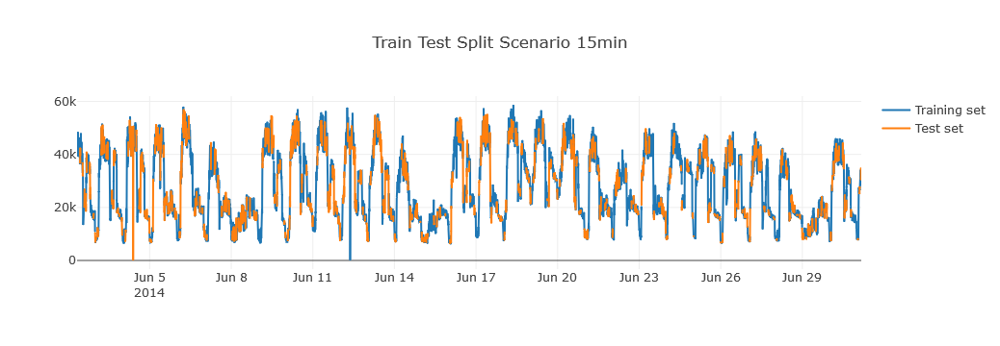

In [89]:
iplot(
    go.Figure(
        data = [go.Scatter(x=df_train_v['date'], y=df_train_v['consumption'], name='Training set'),
                go.Scatter(x=df_test_v['date'], y=df_test_v['consumption'], name='Test set')],
        layout = go.Layout(
            title = f"Train Test Split Scenario {config['gap_scenario']}")
        ))

### Transform to ML useable data

In [36]:
df_energy_ml = df_energy.drop(["timestamp", "date"], axis=1)
for i in range(1, config["window_size"]+1):
    df_energy_ml[f"prev_{i}"] = df_energy_ml["consumption"].shift(i)

cnt_unusable_entries = df_energy_ml.isna().any(axis=1).sum() - 1
df_energy_ml = df_energy_ml.dropna() # do not use the first <window_size> entries for training
train_ids = train_ids[train_ids > cnt_unusable_entries]
df_energy_ml.head(5)

,consumption,prev_1,prev_2,prev_3,prev_4,prev_5,prev_6,prev_7,prev_8,prev_9,prev_10
10,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250,40863.601562,41936.476562,40767.359375
11,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250,40863.601562,41936.476562
12,42095.613281,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250,40863.601562
13,41225.296875,42095.613281,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000,40860.156250
14,44635.769531,41225.296875,42095.613281,41254.898438,40119.933594,42433.210938,41248.468750,41336.214844,42108.781250,41400.218750,44302.625000


In [37]:
df_train = df_energy_ml.loc[train_ids,]
df_test = df_energy_ml.loc[test_ids,]
print(f"Effective train/test ratio is {np.round(df_train.shape[0]/(df_train.shape[0]+df_test.shape[0]), 2)}")

x_train = df_train.drop("consumption", axis=1)
Y_train = df_train["consumption"]
x_test = df_test.drop("consumption", axis=1)
Y_test = df_test["consumption"]

Effective train/test ratio is 0.8


### Utils

In [71]:
from sklearn.metrics import mean_squared_error

def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / (y_true+1e-15))) * 100

### Train our classifier

In [99]:
np.random.seed(config["random_seed"]) # seed again for multiple executions within notebook
feature_types = ["Numerical" for x in x_train.columns]
automl = autosklearn.regression.AutoSklearnRegressor(
        time_left_for_this_task=600,
        per_run_time_limit=60
    )
automl.fit(x_train, Y_train, dataset_name="Power", feat_type=feature_types)

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice



[WARNING] [2019-05-26 14:14:10,527:AutoMLSMBO(1)::Power] Could not find meta-data directory /usr/local/lib/python3.6/dist-packages/autosklearn/metalearning/files/r2_regression_dense
[WARNING] [2019-05-26 14:14:10,548:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:10,561:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:12,590:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:14,597:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:16,603:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:18,608:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:20,614:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:14:22,619:Ensemb

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice



[WARNING] [2019-05-26 14:15:08,850:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:15:10,860:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!
[WARNING] [2019-05-26 14:15:12,883:EnsembleBuilder(1):Power] No models better than random - using Dummy Score!


/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/local/lib/python3.6/dist-packages/autosklearn/evaluation/train_evaluator.py:197: RuntimeWarning:

Mean of empty slice

/usr/loc

AutoSklearnRegressor(delete_output_folder_after_terminate=True,
           delete_tmp_folder_after_terminate=True,
           disable_evaluator_output=False, ensemble_memory_limit=1024,
           ensemble_nbest=50, ensemble_size=50, exclude_estimators=None,
           exclude_preprocessors=None, get_smac_object_callback=None,
           include_estimators=None, include_preprocessors=None,
           initial_configurations_via_metalearning=25, logging_config=None,
           ml_memory_limit=3072, output_folder=None, per_run_time_limit=60,
           resampling_strategy='holdout',
           resampling_strategy_arguments=None, seed=1, shared_mode=False,
           smac_scenario_args=None, time_left_for_this_task=600,
           tmp_folder=None)

In [100]:
predictions = automl.predict(x_test)
print("MAPE score:", mean_absolute_percentage_error(Y_test, predictions))
print("MSE score:", mean_squared_error(Y_test, predictions))
print("RMSE score:", mean_squared_error(Y_test, predictions) ** 0.5)

MAPE score: 2.6452394985684144e+17
MSE score: 1742231.982740759
RMSE score: 1319.9363555644488


In [101]:
# baselines
# always mean
print("Baselines...")
print("Always mean, MAPE score:", mean_absolute_percentage_error(Y_test, np.repeat(Y_train.mean(), Y_test.shape[0])))
print("Always mean, MSE score:", mean_squared_error(Y_test, np.repeat(Y_train.mean(), Y_test.shape[0])))
print("Always mean, RMSE score:", mean_squared_error(Y_test, np.repeat(Y_train.mean(), Y_test.shape[0])) ** 0.5)
print("Always median, MAPE score:", mean_absolute_percentage_error(Y_test, np.repeat(Y_train.median(), Y_test.shape[0])))
print("Always median, MSE score:", mean_squared_error(Y_test, np.repeat(Y_train.median(), Y_test.shape[0])))
print("Always median, RMSE score:", mean_squared_error(Y_test, np.repeat(Y_train.median(), Y_test.shape[0])) ** 0.5)
print("Always previous, MAPE score:", mean_absolute_percentage_error(Y_test, np.nan_to_num(Y_test.shift(1))))
print("Always previous, MSE score:", mean_squared_error(Y_test, np.nan_to_num(Y_test.shift(1))))
print("Always previous, RMSE score:", mean_squared_error(Y_test, np.nan_to_num(Y_test.shift(1))) ** 0.5)

Baselines...
Always mean, MAPE score: 1.6216249924221693e+17
Always mean, MSE score: 162099480.67173842
Always mean, RMSE score: 12731.829431457933
Always median, MAPE score: 1.427292891048825e+17
Always median, MSE score: 174066190.16638657
Always median, RMSE score: 13193.414651498928
Always previous, MAPE score: 2.7347646831675706e+17
Always previous, MSE score: 13212422.289249837
Always previous, RMSE score: 3634.889584189572


## Visualize predictions

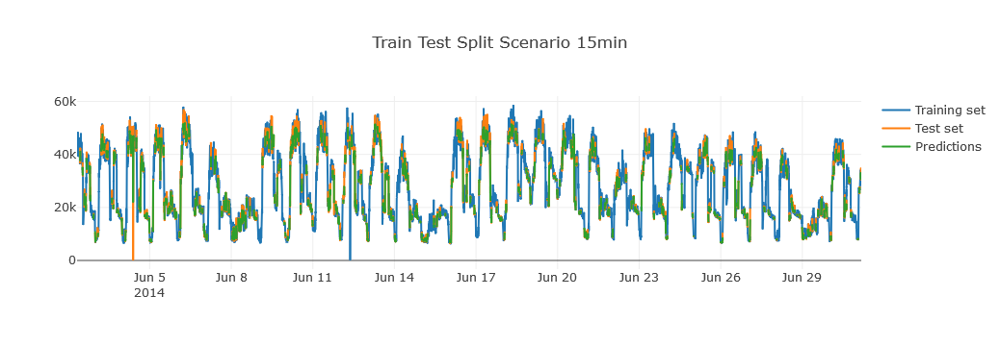

In [102]:
df_test_p = df_test_v.copy()
df_test_p.loc[test_ids,'pred'] = predictions
iplot(
    go.Figure(
        data = [go.Scatter(x=df_train_v['date'], y=df_train_v['consumption'], name='Training set'),
                go.Scatter(x=df_test_v['date'], y=df_test_v['consumption'], name='Test set'),
                go.Scatter(x=df_test_p['date'], y=df_test_p['pred'], name='Predictions')],
        layout = go.Layout(
            title = f"Train Test Split Scenario {config['gap_scenario']}")
        ))

In [103]:
#automl.cv_results_
#automl.sprint_statistics()
automl.show_models()

"[(0.740000, SimpleRegressionPipeline({'categorical_encoding:__choice__': 'one_hot_encoding', 'imputation:strategy': 'median', 'preprocessor:__choice__': 'feature_agglomeration', 'regressor:__choice__': 'random_forest', 'rescaling:__choice__': 'standardize', 'categorical_encoding:one_hot_encoding:use_minimum_fraction': 'True', 'preprocessor:feature_agglomeration:affinity': 'cosine', 'preprocessor:feature_agglomeration:linkage': 'average', 'preprocessor:feature_agglomeration:n_clusters': 55, 'preprocessor:feature_agglomeration:pooling_func': 'max', 'regressor:random_forest:bootstrap': 'False', 'regressor:random_forest:criterion': 'friedman_mse', 'regressor:random_forest:max_depth': 'None', 'regressor:random_forest:max_features': 0.6241787302550422, 'regressor:random_forest:max_leaf_nodes': 'None', 'regressor:random_forest:min_impurity_decrease': 0.0, 'regressor:random_forest:min_samples_leaf': 14, 'regressor:random_forest:min_samples_split': 7, 'regressor:random_forest:min_weight_fracti